In [1]:
%load_ext autoreload
%autoreload 2


In [2]:
from utils import device
import matplotlib.pyplot as plt
from torchvision import transforms
import torchvision
import torch

/opt/conda/lib/python3.7/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /opt/conda/lib/python3.7/site-packages/torchvision/image.so: undefined symbol: _ZN2at4_ops19empty_memory_format4callEN3c108ArrayRefIlEENS2_8optionalINS2_10ScalarTypeEEENS5_INS2_6LayoutEEENS5_INS2_6DeviceEEENS5_IbEENS5_INS2_12MemoryFormatEEE
  warn(f"Failed to load image Python extension: {e}")


In [3]:
torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True

In [4]:
from utils import ImageDataset, ConvResNet, init_dataloader, channel_binary_mask, \
    checkerboard_binary_mask, AffineCouplingLayer, RealNVP, Scale, FinalScale
import torch
from torch.distributions.normal import Normal
from math import log
device = torch.device(device)

In [5]:
# celebA_train_dataset = torchvision.datasets.CelebA(root="/home/ext_amin_unity3d_com/real_nvp_data_celebA",
#                                                    split="train",
#                                                    download=True,
#                                                    transform=transforms.Compose([transforms.ToTensor()])
#                                                    )

In [6]:
# celebA_train_dataloader = torch.utils.data.DataLoader(celebA_train_dataset, batch_size=64)

In [7]:
lsun_train_dataset = ImageDataset(root_dir="/home/ext_amin_unity3d_com/real_nvp_data/train")
lsun_train_dataloader = init_dataloader(lsun_train_dataset)

In [8]:
dataset = lsun_train_dataset
dataloader = lsun_train_dataloader

In [9]:
tmp_input = torch.ones(5, 3, 32, 32).to(device)
tmp_input_split = torch.ones(5, 6, 16, 16).to(device)

In [10]:
scale = Scale().to(device=device)
forwarded_scale, _  = scale(tmp_input)
reversed_scale = scale.reverse(forwarded_scale)
print(torch.norm(tmp_input - reversed_scale))

tensor(nan, device='cuda:0', grad_fn=<NormBackward1>)


In [11]:
final_scale = FinalScale().to(device)
forwarded_fs, _ = final_scale(tmp_input_split)
reversed_fs = final_scale.reverse(forwarded_fs)
print(torch.norm(tmp_input_split - reversed_fs))

tensor(0.6675, device='cuda:0', grad_fn=<NormBackward1>)


In [12]:
def save_plot(n_row, n_column, generated_image, epoch, path):
    fig, ax = plt.subplots(n_row, n_column, squeeze=True)
    fig.subplots_adjust(wspace=.02, hspace=.02)
    for i in range(0, n_row):
        for j in range (0, n_column):
            ax[i, j].axis("off")
            image = (generated_image[i, j].permute([1, 2, 0]).detach().cpu().numpy())
            _ = ax[i, j].imshow(image, aspect="auto")
    plt.suptitle(f"generated_plot epoch {epoch}")
    fig.savefig(f"{path}/generated_image_epoch_{epoch}.png")

In [13]:
realnvp = RealNVP().to(device)
print(f"number of parameters in the model {sum([p.numel() for p in realnvp.parameters()])}")
optimizer = torch.optim.Adam(lr=1e-3, params=realnvp.parameters())

number of parameters in the model 407746


epcoh 0, batch 0, loss 16.54147720336914
epcoh 0, batch 99, loss 6.848881721496582
epcoh 0, batch 198, loss 5.905077934265137
epcoh 0, batch 297, loss 5.337310791015625
epcoh 0, batch 396, loss 5.048161506652832
epcoh 0, batch 495, loss 4.849066257476807
epcoh 0, batch 594, loss 4.6595306396484375
epcoh 0, batch 693, loss 4.606022834777832
epcoh 0, batch 792, loss 4.544427871704102
epcoh 0, batch 891, loss 4.467777729034424
epoch 0, loss: 5.453887462615967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 1, batch 0, loss 4.442652225494385
epcoh 1, batch 99, loss 4.356808662414551
epcoh 1, batch 198, loss 4.331360340118408
epcoh 1, batch 297, loss 4.4189534187316895
epcoh 1, batch 396, loss 4.491185665130615
epcoh 1, batch 495, loss 4.310192584991455
epcoh 1, batch 594, loss 4.261195182800293
epcoh 1, batch 693, loss 4.384176254272461
epcoh 1, batch 792, loss 4.153629302978516
epcoh 1, batch 891, loss 4.120674133300781
epoch 1, loss: 4.3116631507873535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 2, batch 0, loss 4.15978479385376
epcoh 2, batch 99, loss 4.1760783195495605
epcoh 2, batch 198, loss 4.197231292724609
epcoh 2, batch 297, loss 4.270196914672852
epcoh 2, batch 396, loss 4.2365617752075195
epcoh 2, batch 495, loss 4.1430158615112305
epcoh 2, batch 594, loss 4.230982780456543
epcoh 2, batch 693, loss 4.292595863342285
epcoh 2, batch 792, loss 4.054288864135742
epcoh 2, batch 891, loss 4.049586772918701
epoch 2, loss: 4.166987419128418


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 3, batch 0, loss 4.070834159851074
epcoh 3, batch 99, loss 4.087584972381592
epcoh 3, batch 198, loss 4.150673866271973
epcoh 3, batch 297, loss 4.035673141479492
epcoh 3, batch 396, loss 4.133501052856445
epcoh 3, batch 495, loss 4.048133850097656
epcoh 3, batch 594, loss 4.058067321777344
epcoh 3, batch 693, loss 4.195182800292969
epcoh 3, batch 792, loss 4.083747863769531
epcoh 3, batch 891, loss 4.0934600830078125
epoch 3, loss: 4.090195178985596


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 4, batch 0, loss 4.127598762512207
epcoh 4, batch 99, loss 4.063793182373047
epcoh 4, batch 198, loss 4.012294292449951
epcoh 4, batch 297, loss 3.9539971351623535
epcoh 4, batch 396, loss 4.046280860900879
epcoh 4, batch 495, loss 4.055566787719727
epcoh 4, batch 594, loss 4.0809526443481445
epcoh 4, batch 693, loss 4.005814552307129
epcoh 4, batch 792, loss 4.005722999572754
epcoh 4, batch 891, loss 4.026423931121826
epoch 4, loss: 4.038650035858154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 5, batch 0, loss 3.9748830795288086
epcoh 5, batch 99, loss 4.048378944396973
epcoh 5, batch 198, loss 4.006156921386719
epcoh 5, batch 297, loss 4.02000617980957
epcoh 5, batch 396, loss 3.901193618774414
epcoh 5, batch 495, loss 4.013815402984619
epcoh 5, batch 594, loss 4.045443534851074
epcoh 5, batch 693, loss 3.976564884185791
epcoh 5, batch 792, loss 3.990809679031372
epcoh 5, batch 891, loss 3.955059051513672
epoch 5, loss: 3.9994120597839355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 6, batch 0, loss 3.946197509765625
epcoh 6, batch 99, loss 3.876675605773926
epcoh 6, batch 198, loss 3.9473791122436523
epcoh 6, batch 297, loss 3.932454824447632
epcoh 6, batch 396, loss 3.978311777114868
epcoh 6, batch 495, loss 3.9889755249023438
epcoh 6, batch 594, loss 3.967050075531006
epcoh 6, batch 693, loss 3.94106388092041
epcoh 6, batch 792, loss 3.97825026512146
epcoh 6, batch 891, loss 3.974299907684326
epoch 6, loss: 3.954289436340332


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 7, batch 0, loss 3.93477725982666
epcoh 7, batch 99, loss 3.829773426055908
epcoh 7, batch 198, loss 3.9186949729919434
epcoh 7, batch 297, loss 3.857515811920166
epcoh 7, batch 396, loss 3.800342559814453
epcoh 7, batch 495, loss 3.9538989067077637
epcoh 7, batch 594, loss 3.8829352855682373
epcoh 7, batch 693, loss 3.9578285217285156
epcoh 7, batch 792, loss 3.8918161392211914
epcoh 7, batch 891, loss 3.873304605484009
epoch 7, loss: 3.9211502075195312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 8, batch 0, loss 3.917170286178589
epcoh 8, batch 99, loss 3.9237966537475586
epcoh 8, batch 198, loss 3.9784865379333496
epcoh 8, batch 297, loss 3.910892963409424
epcoh 8, batch 396, loss 3.906494140625
epcoh 8, batch 495, loss 3.929774045944214
epcoh 8, batch 594, loss 3.9068329334259033
epcoh 8, batch 693, loss 3.881807327270508
epcoh 8, batch 792, loss 3.9062421321868896
epcoh 8, batch 891, loss 3.898160457611084
epoch 8, loss: 3.8994250297546387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 9, batch 0, loss 3.896584987640381
epcoh 9, batch 99, loss 3.907649040222168
epcoh 9, batch 198, loss 4.06110143661499
epcoh 9, batch 297, loss 3.8965706825256348
epcoh 9, batch 396, loss 3.9199929237365723
epcoh 9, batch 495, loss 3.8963286876678467
epcoh 9, batch 594, loss 3.927128314971924
epcoh 9, batch 693, loss 3.9955101013183594
epcoh 9, batch 792, loss 3.8587546348571777
epcoh 9, batch 891, loss 3.8611979484558105
epoch 9, loss: 3.8962061405181885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 10, batch 0, loss 3.819735288619995
epcoh 10, batch 99, loss 3.895813465118408
epcoh 10, batch 198, loss 3.8905997276306152
epcoh 10, batch 297, loss 3.9399800300598145
epcoh 10, batch 396, loss 3.8786091804504395
epcoh 10, batch 495, loss 3.746856689453125
epcoh 10, batch 594, loss 3.888706922531128
epcoh 10, batch 693, loss 3.9027884006500244
epcoh 10, batch 792, loss 3.916901111602783
epcoh 10, batch 891, loss 3.8513286113739014
epoch 10, loss: 3.8676440715789795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 11, batch 0, loss 3.8273653984069824
epcoh 11, batch 99, loss 3.836639881134033
epcoh 11, batch 198, loss 3.8542795181274414
epcoh 11, batch 297, loss 3.8078668117523193
epcoh 11, batch 396, loss 3.9803895950317383
epcoh 11, batch 495, loss 3.824953079223633
epcoh 11, batch 594, loss 3.8396060466766357
epcoh 11, batch 693, loss 3.8768768310546875
epcoh 11, batch 792, loss 3.8251049518585205
epcoh 11, batch 891, loss 3.854691505432129
epoch 11, loss: 3.8539845943450928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 12, batch 0, loss 3.9527244567871094
epcoh 12, batch 99, loss 3.8579678535461426
epcoh 12, batch 198, loss 3.7904491424560547
epcoh 12, batch 297, loss 3.90468168258667
epcoh 12, batch 396, loss 3.8760595321655273
epcoh 12, batch 495, loss 3.873603105545044
epcoh 12, batch 594, loss 3.840853691101074
epcoh 12, batch 693, loss 3.7630913257598877
epcoh 12, batch 792, loss 3.7973580360412598
epcoh 12, batch 891, loss 3.788060426712036
epoch 12, loss: 3.842500925064087


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 13, batch 0, loss 3.8016610145568848
epcoh 13, batch 99, loss 3.8117151260375977
epcoh 13, batch 198, loss 3.846754312515259
epcoh 13, batch 297, loss 3.837331771850586
epcoh 13, batch 396, loss 3.797426700592041
epcoh 13, batch 495, loss 3.768545150756836
epcoh 13, batch 594, loss 3.8358802795410156
epcoh 13, batch 693, loss 3.7897000312805176
epcoh 13, batch 792, loss 3.8956096172332764
epcoh 13, batch 891, loss 3.821955680847168
epoch 13, loss: 3.834001064300537


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 14, batch 0, loss 3.85087251663208
epcoh 14, batch 99, loss 3.836519956588745
epcoh 14, batch 198, loss 3.815300464630127
epcoh 14, batch 297, loss 3.819401264190674
epcoh 14, batch 396, loss 3.9012765884399414
epcoh 14, batch 495, loss 3.8421030044555664
epcoh 14, batch 594, loss 3.7832601070404053
epcoh 14, batch 693, loss 3.8630728721618652
epcoh 14, batch 792, loss 3.75130558013916
epcoh 14, batch 891, loss 3.8696188926696777
epoch 14, loss: 3.824648141860962


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 15, batch 0, loss 3.837874412536621
epcoh 15, batch 99, loss 3.809133768081665
epcoh 15, batch 198, loss 3.754333972930908
epcoh 15, batch 297, loss 3.868795871734619
epcoh 15, batch 396, loss 3.8901000022888184
epcoh 15, batch 495, loss 3.853811025619507
epcoh 15, batch 594, loss 3.7804408073425293
epcoh 15, batch 693, loss 3.8144140243530273
epcoh 15, batch 792, loss 3.7491650581359863
epcoh 15, batch 891, loss 3.8228325843811035
epoch 15, loss: 3.817647695541382


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 16, batch 0, loss 3.839639663696289
epcoh 16, batch 99, loss 3.787433385848999
epcoh 16, batch 198, loss 3.8202834129333496
epcoh 16, batch 297, loss 3.759800434112549
epcoh 16, batch 396, loss 3.8437957763671875
epcoh 16, batch 495, loss 3.7994985580444336
epcoh 16, batch 594, loss 3.8526391983032227
epcoh 16, batch 693, loss 3.817251205444336
epcoh 16, batch 792, loss 3.7729263305664062
epcoh 16, batch 891, loss 3.8089427947998047
epoch 16, loss: 3.8079516887664795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 17, batch 0, loss 3.8037683963775635
epcoh 17, batch 99, loss 3.772339344024658
epcoh 17, batch 198, loss 3.737456798553467
epcoh 17, batch 297, loss 3.7581961154937744
epcoh 17, batch 396, loss 3.8121848106384277
epcoh 17, batch 495, loss 3.7893590927124023
epcoh 17, batch 594, loss 3.750314712524414
epcoh 17, batch 693, loss 3.8122718334198
epcoh 17, batch 792, loss 3.8549981117248535
epcoh 17, batch 891, loss 3.8106207847595215
epoch 17, loss: 3.802826166152954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 18, batch 0, loss 3.7840185165405273
epcoh 18, batch 99, loss 3.8156630992889404
epcoh 18, batch 198, loss 3.7362170219421387
epcoh 18, batch 297, loss 3.779301643371582
epcoh 18, batch 396, loss 3.81370210647583
epcoh 18, batch 495, loss 3.7242956161499023
epcoh 18, batch 594, loss 3.761538505554199
epcoh 18, batch 693, loss 3.889841079711914
epcoh 18, batch 792, loss 3.781787872314453
epcoh 18, batch 891, loss 3.7877659797668457
epoch 18, loss: 3.7958667278289795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 19, batch 0, loss 3.7489891052246094
epcoh 19, batch 99, loss 3.757819414138794
epcoh 19, batch 198, loss 3.874544620513916
epcoh 19, batch 297, loss 3.8119609355926514
epcoh 19, batch 396, loss 3.8852243423461914
epcoh 19, batch 495, loss 3.8314971923828125
epcoh 19, batch 594, loss 3.7810492515563965
epcoh 19, batch 693, loss 3.8703765869140625
epcoh 19, batch 792, loss 3.7847843170166016
epcoh 19, batch 891, loss 3.800283432006836
epoch 19, loss: 3.7905197143554688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 20, batch 0, loss 3.75754714012146
epcoh 20, batch 99, loss 3.7465062141418457
epcoh 20, batch 198, loss 3.824648141860962
epcoh 20, batch 297, loss 3.7785496711730957
epcoh 20, batch 396, loss 3.7363483905792236
epcoh 20, batch 495, loss 3.72698974609375
epcoh 20, batch 594, loss 3.7732415199279785
epcoh 20, batch 693, loss 3.742227554321289
epcoh 20, batch 792, loss 3.7822868824005127
epcoh 20, batch 891, loss 3.755513906478882
epoch 20, loss: 3.785370349884033


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clip

epcoh 21, batch 0, loss 3.7938551902770996
epcoh 21, batch 99, loss 3.778705358505249
epcoh 21, batch 198, loss 3.8619368076324463
epcoh 21, batch 297, loss 3.781646728515625
epcoh 21, batch 396, loss 3.774164915084839
epcoh 21, batch 495, loss 3.768239974975586
epcoh 21, batch 594, loss 3.822908401489258
epcoh 21, batch 693, loss 3.801623821258545
epcoh 21, batch 792, loss 3.7090094089508057
epcoh 21, batch 891, loss 3.889134407043457
epoch 21, loss: 3.7800869941711426


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 22, batch 0, loss 3.8861143589019775
epcoh 22, batch 99, loss 3.666400909423828
epcoh 22, batch 198, loss 3.761843204498291
epcoh 22, batch 297, loss 3.7955586910247803
epcoh 22, batch 396, loss 3.713674306869507
epcoh 22, batch 495, loss 3.7650671005249023
epcoh 22, batch 594, loss 3.8721046447753906
epcoh 22, batch 693, loss 3.833806037902832
epcoh 22, batch 792, loss 3.747159957885742
epcoh 22, batch 891, loss 3.713041305541992
epoch 22, loss: 3.7753281593322754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 23, batch 0, loss 3.805689811706543
epcoh 23, batch 99, loss 3.6972217559814453
epcoh 23, batch 198, loss 3.7072298526763916
epcoh 23, batch 297, loss 3.765191078186035
epcoh 23, batch 396, loss 3.808359146118164
epcoh 23, batch 495, loss 3.749134063720703
epcoh 23, batch 594, loss 3.8084707260131836
epcoh 23, batch 693, loss 3.825751304626465
epcoh 23, batch 792, loss 3.8270468711853027
epcoh 23, batch 891, loss 3.7810440063476562
epoch 23, loss: 3.7718582153320312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 24, batch 0, loss 3.740854263305664
epcoh 24, batch 99, loss 3.775885581970215
epcoh 24, batch 198, loss 3.848093271255493
epcoh 24, batch 297, loss 3.8245737552642822
epcoh 24, batch 396, loss 3.8208847045898438
epcoh 24, batch 495, loss 3.794898271560669
epcoh 24, batch 594, loss 3.745828151702881
epcoh 24, batch 693, loss 3.709209680557251
epcoh 24, batch 792, loss 3.714103937149048
epcoh 24, batch 891, loss 3.839984893798828
epoch 24, loss: 3.7679858207702637


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 25, batch 0, loss 3.70497989654541
epcoh 25, batch 99, loss 3.7180066108703613
epcoh 25, batch 198, loss 3.71529483795166
epcoh 25, batch 297, loss 3.7757081985473633
epcoh 25, batch 396, loss 3.767887592315674
epcoh 25, batch 495, loss 3.7063684463500977
epcoh 25, batch 594, loss 3.789094924926758
epcoh 25, batch 693, loss 3.800239086151123
epcoh 25, batch 792, loss 3.703298568725586
epcoh 25, batch 891, loss 3.826742172241211
epoch 25, loss: 3.7638189792633057


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 26, batch 0, loss 3.8265581130981445
epcoh 26, batch 99, loss 3.7626585960388184
epcoh 26, batch 198, loss 3.7243518829345703
epcoh 26, batch 297, loss 3.7740120887756348
epcoh 26, batch 396, loss 3.82289719581604
epcoh 26, batch 495, loss 3.72548246383667
epcoh 26, batch 594, loss 3.772451877593994
epcoh 26, batch 693, loss 3.6981561183929443
epcoh 26, batch 792, loss 3.737110137939453
epcoh 26, batch 891, loss 3.832974433898926
epoch 26, loss: 3.7600696086883545


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 27, batch 0, loss 3.7529938220977783
epcoh 27, batch 99, loss 3.721980094909668
epcoh 27, batch 198, loss 3.8507113456726074
epcoh 27, batch 297, loss 3.803051471710205
epcoh 27, batch 396, loss 3.752535820007324
epcoh 27, batch 495, loss 3.766842842102051
epcoh 27, batch 594, loss 3.754878520965576
epcoh 27, batch 693, loss 3.7680487632751465
epcoh 27, batch 792, loss 3.747689723968506
epcoh 27, batch 891, loss 3.7608978748321533
epoch 27, loss: 3.7562758922576904


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 28, batch 0, loss 3.817403554916382
epcoh 28, batch 99, loss 3.7304844856262207
epcoh 28, batch 198, loss 3.827360153198242
epcoh 28, batch 297, loss 3.722158432006836
epcoh 28, batch 396, loss 3.683116912841797
epcoh 28, batch 495, loss 3.6608033180236816
epcoh 28, batch 594, loss 3.7085213661193848
epcoh 28, batch 693, loss 3.706056594848633
epcoh 28, batch 792, loss 3.7405080795288086
epcoh 28, batch 891, loss 3.7033400535583496
epoch 28, loss: 3.753537654876709


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 29, batch 0, loss 3.720815658569336
epcoh 29, batch 99, loss 3.817716121673584
epcoh 29, batch 198, loss 3.7356858253479004
epcoh 29, batch 297, loss 3.7264015674591064
epcoh 29, batch 396, loss 3.7281153202056885
epcoh 29, batch 495, loss 3.73992919921875
epcoh 29, batch 594, loss 3.7933268547058105
epcoh 29, batch 693, loss 3.724409818649292
epcoh 29, batch 792, loss 3.7973055839538574
epcoh 29, batch 891, loss 3.6918585300445557
epoch 29, loss: 3.751016855239868


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 30, batch 0, loss 3.7190821170806885
epcoh 30, batch 99, loss 3.7628700733184814
epcoh 30, batch 198, loss 3.7523417472839355
epcoh 30, batch 297, loss 3.811155080795288
epcoh 30, batch 396, loss 3.7066168785095215
epcoh 30, batch 495, loss 3.8212201595306396
epcoh 30, batch 594, loss 3.762249231338501
epcoh 30, batch 693, loss 3.7859063148498535
epcoh 30, batch 792, loss 3.799105167388916
epcoh 30, batch 891, loss 3.6906633377075195
epoch 30, loss: 3.7479941844940186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 31, batch 0, loss 3.8091325759887695
epcoh 31, batch 99, loss 3.6675872802734375
epcoh 31, batch 198, loss 3.721825122833252
epcoh 31, batch 297, loss 3.7375755310058594
epcoh 31, batch 396, loss 3.7105584144592285
epcoh 31, batch 495, loss 3.8401296138763428
epcoh 31, batch 594, loss 3.740386724472046
epcoh 31, batch 693, loss 3.7257065773010254
epcoh 31, batch 792, loss 3.740591526031494
epcoh 31, batch 891, loss 3.7032594680786133
epoch 31, loss: 3.745530366897583


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 32, batch 0, loss 3.6879401206970215
epcoh 32, batch 99, loss 3.6872498989105225
epcoh 32, batch 198, loss 3.7700510025024414
epcoh 32, batch 297, loss 3.678569793701172
epcoh 32, batch 396, loss 3.7335896492004395
epcoh 32, batch 495, loss 3.689948558807373
epcoh 32, batch 594, loss 3.722090721130371
epcoh 32, batch 693, loss 3.746795654296875
epcoh 32, batch 792, loss 3.7366576194763184
epcoh 32, batch 891, loss 3.7502222061157227
epoch 32, loss: 3.742020606994629


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 33, batch 0, loss 3.7904434204101562
epcoh 33, batch 99, loss 3.7865824699401855
epcoh 33, batch 198, loss 3.7577672004699707
epcoh 33, batch 297, loss 3.818413019180298
epcoh 33, batch 396, loss 3.6959657669067383
epcoh 33, batch 495, loss 3.7473278045654297
epcoh 33, batch 594, loss 3.6663119792938232
epcoh 33, batch 693, loss 3.7538657188415527
epcoh 33, batch 792, loss 3.772149085998535
epcoh 33, batch 891, loss 3.7549874782562256
epoch 33, loss: 3.741065502166748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 34, batch 0, loss 3.696707010269165
epcoh 34, batch 99, loss 3.769582748413086
epcoh 34, batch 198, loss 3.7496700286865234
epcoh 34, batch 297, loss 3.829869508743286
epcoh 34, batch 396, loss 3.747002363204956
epcoh 34, batch 495, loss 3.728620767593384
epcoh 34, batch 594, loss 3.7334232330322266
epcoh 34, batch 693, loss 3.810378074645996
epcoh 34, batch 792, loss 3.7351741790771484
epcoh 34, batch 891, loss 3.7302706241607666
epoch 34, loss: 3.73884916305542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 35, batch 0, loss 3.776207447052002
epcoh 35, batch 99, loss 3.7621731758117676
epcoh 35, batch 198, loss 3.6738460063934326
epcoh 35, batch 297, loss 3.694873094558716
epcoh 35, batch 396, loss 3.811122417449951
epcoh 35, batch 495, loss 3.7810497283935547
epcoh 35, batch 594, loss 3.697176933288574
epcoh 35, batch 693, loss 3.6671204566955566
epcoh 35, batch 792, loss 3.7317700386047363
epcoh 35, batch 891, loss 3.711184501647949
epoch 35, loss: 3.7367103099823


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 36, batch 0, loss 3.757702350616455
epcoh 36, batch 99, loss 3.711470127105713
epcoh 36, batch 198, loss 3.692014217376709
epcoh 36, batch 297, loss 3.7051024436950684
epcoh 36, batch 396, loss 3.7404098510742188
epcoh 36, batch 495, loss 3.794398307800293
epcoh 36, batch 594, loss 3.726727247238159
epcoh 36, batch 693, loss 3.712786912918091
epcoh 36, batch 792, loss 3.7243809700012207
epcoh 36, batch 891, loss 3.715996265411377
epoch 36, loss: 3.7340376377105713


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 37, batch 0, loss 3.821004867553711
epcoh 37, batch 99, loss 3.6620302200317383
epcoh 37, batch 198, loss 3.6960370540618896
epcoh 37, batch 297, loss 3.6723122596740723
epcoh 37, batch 396, loss 3.8452224731445312
epcoh 37, batch 495, loss 3.68664288520813
epcoh 37, batch 594, loss 3.7739429473876953
epcoh 37, batch 693, loss 3.729310989379883
epcoh 37, batch 792, loss 3.658594846725464
epcoh 37, batch 891, loss 3.732346534729004
epoch 37, loss: 3.7331669330596924


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 38, batch 0, loss 3.728519916534424
epcoh 38, batch 99, loss 3.768899440765381
epcoh 38, batch 198, loss 3.7617878913879395
epcoh 38, batch 297, loss 3.728040933609009
epcoh 38, batch 396, loss 3.6841964721679688
epcoh 38, batch 495, loss 3.6295082569122314
epcoh 38, batch 594, loss 3.7259442806243896
epcoh 38, batch 693, loss 3.766564130783081
epcoh 38, batch 792, loss 3.7690303325653076
epcoh 38, batch 891, loss 3.7424538135528564
epoch 38, loss: 3.7299997806549072


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 39, batch 0, loss 3.7494730949401855
epcoh 39, batch 99, loss 3.7126286029815674
epcoh 39, batch 198, loss 3.7433505058288574
epcoh 39, batch 297, loss 3.7887160778045654
epcoh 39, batch 396, loss 3.8095884323120117
epcoh 39, batch 495, loss 3.7652385234832764
epcoh 39, batch 594, loss 3.7309961318969727
epcoh 39, batch 693, loss 3.7361769676208496
epcoh 39, batch 792, loss 3.7091732025146484
epcoh 39, batch 891, loss 3.7318532466888428
epoch 39, loss: 3.7284531593322754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 40, batch 0, loss 3.7478935718536377
epcoh 40, batch 99, loss 3.782125473022461
epcoh 40, batch 198, loss 3.7243247032165527
epcoh 40, batch 297, loss 3.7705130577087402
epcoh 40, batch 396, loss 3.711881160736084
epcoh 40, batch 495, loss 3.7765583992004395
epcoh 40, batch 594, loss 3.7486932277679443
epcoh 40, batch 693, loss 3.643932342529297
epcoh 40, batch 792, loss 3.7100958824157715
epcoh 40, batch 891, loss 3.651270627975464
epoch 40, loss: 3.7275102138519287


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 41, batch 0, loss 3.7722699642181396
epcoh 41, batch 99, loss 3.7682976722717285
epcoh 41, batch 198, loss 3.723710060119629
epcoh 41, batch 297, loss 3.7742533683776855
epcoh 41, batch 396, loss 3.7248001098632812
epcoh 41, batch 495, loss 3.7575278282165527
epcoh 41, batch 594, loss 3.7678253650665283
epcoh 41, batch 693, loss 3.6530561447143555
epcoh 41, batch 792, loss 3.745027542114258
epcoh 41, batch 891, loss 3.755496025085449
epoch 41, loss: 3.7259209156036377


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 42, batch 0, loss 3.794900894165039
epcoh 42, batch 99, loss 3.745708465576172
epcoh 42, batch 198, loss 3.758326292037964
epcoh 42, batch 297, loss 3.726496458053589
epcoh 42, batch 396, loss 3.7409563064575195
epcoh 42, batch 495, loss 3.763735771179199
epcoh 42, batch 594, loss 3.722607135772705
epcoh 42, batch 693, loss 3.6905272006988525
epcoh 42, batch 792, loss 3.7302215099334717
epcoh 42, batch 891, loss 3.7969889640808105
epoch 42, loss: 3.724217414855957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 43, batch 0, loss 3.6678295135498047
epcoh 43, batch 99, loss 3.666517734527588
epcoh 43, batch 198, loss 3.6706037521362305
epcoh 43, batch 297, loss 3.695296287536621
epcoh 43, batch 396, loss 3.753654956817627
epcoh 43, batch 495, loss 3.7439751625061035
epcoh 43, batch 594, loss 3.704848051071167
epcoh 43, batch 693, loss 3.7075769901275635
epcoh 43, batch 792, loss 3.7374014854431152
epcoh 43, batch 891, loss 3.653846263885498
epoch 43, loss: 3.7220029830932617


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 44, batch 0, loss 3.703779458999634
epcoh 44, batch 99, loss 3.7001492977142334
epcoh 44, batch 198, loss 3.771831512451172
epcoh 44, batch 297, loss 3.7614541053771973
epcoh 44, batch 396, loss 3.7118256092071533
epcoh 44, batch 495, loss 3.732795238494873
epcoh 44, batch 594, loss 3.7321934700012207
epcoh 44, batch 693, loss 3.640512704849243
epcoh 44, batch 792, loss 3.6822032928466797
epcoh 44, batch 891, loss 3.6728382110595703
epoch 44, loss: 3.722167730331421


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 45, batch 0, loss 3.7761030197143555
epcoh 45, batch 99, loss 3.6915955543518066
epcoh 45, batch 198, loss 3.739025592803955
epcoh 45, batch 297, loss 3.74817156791687
epcoh 45, batch 396, loss 3.770303726196289
epcoh 45, batch 495, loss 3.6743011474609375
epcoh 45, batch 594, loss 3.745636463165283
epcoh 45, batch 693, loss 3.761577606201172
epcoh 45, batch 792, loss 3.7033910751342773
epcoh 45, batch 891, loss 3.6734323501586914
epoch 45, loss: 3.7202000617980957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 46, batch 0, loss 3.7579221725463867
epcoh 46, batch 99, loss 3.714940071105957
epcoh 46, batch 198, loss 3.725986957550049
epcoh 46, batch 297, loss 3.7498369216918945
epcoh 46, batch 396, loss 3.783724784851074
epcoh 46, batch 495, loss 3.840061902999878
epcoh 46, batch 594, loss 3.734131097793579
epcoh 46, batch 693, loss 3.8181042671203613
epcoh 46, batch 792, loss 3.7714614868164062
epcoh 46, batch 891, loss 3.7515363693237305
epoch 46, loss: 3.7185440063476562


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 47, batch 0, loss 3.717254638671875
epcoh 47, batch 99, loss 3.7690351009368896
epcoh 47, batch 198, loss 3.702435255050659
epcoh 47, batch 297, loss 3.7703053951263428
epcoh 47, batch 396, loss 3.7416787147521973
epcoh 47, batch 495, loss 3.724510669708252
epcoh 47, batch 594, loss 3.746664524078369
epcoh 47, batch 693, loss 3.6514413356781006
epcoh 47, batch 792, loss 3.699936866760254
epcoh 47, batch 891, loss 3.703561782836914
epoch 47, loss: 3.7174112796783447


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 48, batch 0, loss 3.7466835975646973
epcoh 48, batch 99, loss 3.723780870437622
epcoh 48, batch 198, loss 3.6526670455932617
epcoh 48, batch 297, loss 3.813730001449585
epcoh 48, batch 396, loss 3.76987886428833
epcoh 48, batch 495, loss 3.7242627143859863
epcoh 48, batch 594, loss 3.6904473304748535
epcoh 48, batch 693, loss 3.838636875152588
epcoh 48, batch 792, loss 3.646477222442627
epcoh 48, batch 891, loss 3.735276222229004
epoch 48, loss: 3.715937852859497


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 49, batch 0, loss 3.753777027130127
epcoh 49, batch 99, loss 3.704113245010376
epcoh 49, batch 198, loss 3.728632926940918
epcoh 49, batch 297, loss 3.812509059906006
epcoh 49, batch 396, loss 3.65348482131958
epcoh 49, batch 495, loss 3.718430519104004
epcoh 49, batch 594, loss 3.742675304412842
epcoh 49, batch 693, loss 3.702341079711914
epcoh 49, batch 792, loss 3.7365546226501465
epcoh 49, batch 891, loss 3.717373847961426
epoch 49, loss: 3.7150163650512695


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 50, batch 0, loss 3.677213668823242
epcoh 50, batch 99, loss 3.7331950664520264
epcoh 50, batch 198, loss 3.7286500930786133
epcoh 50, batch 297, loss 3.701552152633667
epcoh 50, batch 396, loss 3.677891731262207
epcoh 50, batch 495, loss 3.7014403343200684
epcoh 50, batch 594, loss 3.755831480026245
epcoh 50, batch 693, loss 3.6530001163482666
epcoh 50, batch 792, loss 3.7230453491210938
epcoh 50, batch 891, loss 3.7373147010803223
epoch 50, loss: 3.7137808799743652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 51, batch 0, loss 3.6912550926208496
epcoh 51, batch 99, loss 3.6492252349853516
epcoh 51, batch 198, loss 3.664137363433838
epcoh 51, batch 297, loss 3.7733702659606934
epcoh 51, batch 396, loss 3.708509922027588
epcoh 51, batch 495, loss 3.7570409774780273
epcoh 51, batch 594, loss 3.6995649337768555
epcoh 51, batch 693, loss 3.692167043685913
epcoh 51, batch 792, loss 3.705838203430176
epcoh 51, batch 891, loss 3.7526581287384033
epoch 51, loss: 3.712519645690918


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 52, batch 0, loss 3.6767783164978027
epcoh 52, batch 99, loss 3.668196201324463
epcoh 52, batch 198, loss 3.6779661178588867
epcoh 52, batch 297, loss 3.7912070751190186
epcoh 52, batch 396, loss 3.7118494510650635
epcoh 52, batch 495, loss 3.6730470657348633
epcoh 52, batch 594, loss 3.6681017875671387
epcoh 52, batch 693, loss 3.8195080757141113
epcoh 52, batch 792, loss 3.7537600994110107
epcoh 52, batch 891, loss 3.691098690032959
epoch 52, loss: 3.7112069129943848


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 53, batch 0, loss 3.7276570796966553
epcoh 53, batch 99, loss 3.68540358543396
epcoh 53, batch 198, loss 3.7382874488830566
epcoh 53, batch 297, loss 3.8025169372558594
epcoh 53, batch 396, loss 3.6269593238830566
epcoh 53, batch 495, loss 3.730544090270996
epcoh 53, batch 594, loss 3.6864748001098633
epcoh 53, batch 693, loss 3.6687655448913574
epcoh 53, batch 792, loss 3.727736473083496
epcoh 53, batch 891, loss 3.7248849868774414
epoch 53, loss: 3.710397958755493


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 54, batch 0, loss 3.7978734970092773
epcoh 54, batch 99, loss 3.7842955589294434
epcoh 54, batch 198, loss 3.670124053955078
epcoh 54, batch 297, loss 3.7612104415893555
epcoh 54, batch 396, loss 3.7989678382873535
epcoh 54, batch 495, loss 3.6927151679992676
epcoh 54, batch 594, loss 3.7778830528259277
epcoh 54, batch 693, loss 3.764437675476074
epcoh 54, batch 792, loss 3.724601984024048
epcoh 54, batch 891, loss 3.744272232055664
epoch 54, loss: 3.7088515758514404


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 55, batch 0, loss 3.801659107208252
epcoh 55, batch 99, loss 3.713542938232422
epcoh 55, batch 198, loss 3.657942295074463
epcoh 55, batch 297, loss 3.732569694519043
epcoh 55, batch 396, loss 3.6802308559417725
epcoh 55, batch 495, loss 3.666844606399536
epcoh 55, batch 594, loss 3.6797118186950684
epcoh 55, batch 693, loss 3.683999538421631
epcoh 55, batch 792, loss 3.740835666656494
epcoh 55, batch 891, loss 3.7577877044677734
epoch 55, loss: 3.7083065509796143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 56, batch 0, loss 3.7190232276916504
epcoh 56, batch 99, loss 3.685237407684326
epcoh 56, batch 198, loss 3.7317075729370117
epcoh 56, batch 297, loss 3.7322354316711426
epcoh 56, batch 396, loss 3.7305209636688232
epcoh 56, batch 495, loss 3.7485222816467285
epcoh 56, batch 594, loss 3.7009363174438477
epcoh 56, batch 693, loss 3.6935830116271973
epcoh 56, batch 792, loss 3.7029078006744385
epcoh 56, batch 891, loss 3.72613263130188
epoch 56, loss: 3.707362413406372


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 57, batch 0, loss 3.7185187339782715
epcoh 57, batch 99, loss 3.7329602241516113
epcoh 57, batch 198, loss 3.7188143730163574
epcoh 57, batch 297, loss 3.6884703636169434
epcoh 57, batch 396, loss 3.751282215118408
epcoh 57, batch 495, loss 3.6420540809631348
epcoh 57, batch 594, loss 3.692228317260742
epcoh 57, batch 693, loss 3.730206251144409
epcoh 57, batch 792, loss 3.6694464683532715
epcoh 57, batch 891, loss 3.6894967555999756
epoch 57, loss: 3.70638108253479


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 58, batch 0, loss 3.7065021991729736
epcoh 58, batch 99, loss 3.8065414428710938
epcoh 58, batch 198, loss 3.7724521160125732
epcoh 58, batch 297, loss 3.7357335090637207
epcoh 58, batch 396, loss 3.6678080558776855
epcoh 58, batch 495, loss 3.692831039428711
epcoh 58, batch 594, loss 3.6681935787200928
epcoh 58, batch 693, loss 3.6654911041259766
epcoh 58, batch 792, loss 3.7183303833007812
epcoh 58, batch 891, loss 3.7823922634124756
epoch 58, loss: 3.7050864696502686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 59, batch 0, loss 3.7194414138793945
epcoh 59, batch 99, loss 3.7667014598846436
epcoh 59, batch 198, loss 3.725602626800537
epcoh 59, batch 297, loss 3.7556724548339844
epcoh 59, batch 396, loss 3.7137598991394043
epcoh 59, batch 495, loss 3.7125821113586426
epcoh 59, batch 594, loss 3.6750094890594482
epcoh 59, batch 693, loss 3.747091054916382
epcoh 59, batch 792, loss 3.680091619491577
epcoh 59, batch 891, loss 3.72336483001709
epoch 59, loss: 3.7044780254364014


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 60, batch 0, loss 3.6690125465393066
epcoh 60, batch 99, loss 3.7159461975097656
epcoh 60, batch 198, loss 3.67752742767334
epcoh 60, batch 297, loss 3.7842483520507812
epcoh 60, batch 396, loss 3.7301177978515625
epcoh 60, batch 495, loss 3.6684179306030273
epcoh 60, batch 594, loss 3.6989870071411133
epcoh 60, batch 693, loss 3.7226510047912598
epcoh 60, batch 792, loss 3.76747465133667
epcoh 60, batch 891, loss 3.7506284713745117
epoch 60, loss: 3.702911615371704


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 61, batch 0, loss 3.747685432434082
epcoh 61, batch 99, loss 3.7369284629821777
epcoh 61, batch 198, loss 3.7195260524749756
epcoh 61, batch 297, loss 3.7186152935028076
epcoh 61, batch 396, loss 3.752711296081543
epcoh 61, batch 495, loss 3.6506857872009277
epcoh 61, batch 594, loss 3.6914548873901367
epcoh 61, batch 693, loss 3.705211877822876
epcoh 61, batch 792, loss 3.6773464679718018
epcoh 61, batch 891, loss 3.7568843364715576
epoch 61, loss: 3.7016305923461914


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 62, batch 0, loss 3.7481112480163574
epcoh 62, batch 99, loss 3.649737596511841
epcoh 62, batch 198, loss 3.6479272842407227
epcoh 62, batch 297, loss 3.6971240043640137
epcoh 62, batch 396, loss 3.6361021995544434
epcoh 62, batch 495, loss 3.737571954727173
epcoh 62, batch 594, loss 3.7106785774230957
epcoh 62, batch 693, loss 3.6331281661987305
epcoh 62, batch 792, loss 3.7208495140075684
epcoh 62, batch 891, loss 3.6982617378234863
epoch 62, loss: 3.701284885406494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 63, batch 0, loss 3.6562347412109375
epcoh 63, batch 99, loss 3.7787039279937744
epcoh 63, batch 198, loss 3.737349510192871
epcoh 63, batch 297, loss 3.7494893074035645
epcoh 63, batch 396, loss 3.7319936752319336
epcoh 63, batch 495, loss 3.7154181003570557
epcoh 63, batch 594, loss 3.7146027088165283
epcoh 63, batch 693, loss 3.709071159362793
epcoh 63, batch 792, loss 3.742262840270996
epcoh 63, batch 891, loss 3.7115273475646973
epoch 63, loss: 3.7005012035369873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 64, batch 0, loss 3.695263385772705
epcoh 64, batch 99, loss 3.7044944763183594
epcoh 64, batch 198, loss 3.68259859085083
epcoh 64, batch 297, loss 3.668301582336426
epcoh 64, batch 396, loss 3.6995339393615723
epcoh 64, batch 495, loss 3.694225311279297
epcoh 64, batch 594, loss 3.686262607574463
epcoh 64, batch 693, loss 3.604257106781006
epcoh 64, batch 792, loss 3.7194769382476807
epcoh 64, batch 891, loss 3.7729220390319824
epoch 64, loss: 3.6994597911834717


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 65, batch 0, loss 3.615931987762451
epcoh 65, batch 99, loss 3.73222017288208
epcoh 65, batch 198, loss 3.633938789367676
epcoh 65, batch 297, loss 3.7076754570007324
epcoh 65, batch 396, loss 3.716433525085449
epcoh 65, batch 495, loss 3.687351942062378
epcoh 65, batch 594, loss 3.738402843475342
epcoh 65, batch 693, loss 3.633849620819092
epcoh 65, batch 792, loss 3.712434768676758
epcoh 65, batch 891, loss 3.7752208709716797
epoch 65, loss: 3.6981494426727295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 66, batch 0, loss 3.697380304336548
epcoh 66, batch 99, loss 3.678187847137451
epcoh 66, batch 198, loss 3.701064109802246
epcoh 66, batch 297, loss 3.6852669715881348
epcoh 66, batch 396, loss 3.643892765045166
epcoh 66, batch 495, loss 3.7274394035339355
epcoh 66, batch 594, loss 3.7557260990142822
epcoh 66, batch 693, loss 3.6729841232299805
epcoh 66, batch 792, loss 3.714675188064575
epcoh 66, batch 891, loss 3.658249855041504
epoch 66, loss: 3.697608470916748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 67, batch 0, loss 3.7024571895599365
epcoh 67, batch 99, loss 3.729905128479004
epcoh 67, batch 198, loss 3.6576123237609863
epcoh 67, batch 297, loss 3.6920278072357178
epcoh 67, batch 396, loss 3.6683645248413086
epcoh 67, batch 495, loss 3.6280853748321533
epcoh 67, batch 594, loss 3.7246944904327393
epcoh 67, batch 693, loss 3.6252598762512207
epcoh 67, batch 792, loss 3.729160785675049
epcoh 67, batch 891, loss 3.714427947998047
epoch 67, loss: 3.696739435195923


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 68, batch 0, loss 3.6826798915863037
epcoh 68, batch 99, loss 3.7170588970184326
epcoh 68, batch 198, loss 3.6825180053710938
epcoh 68, batch 297, loss 3.7011594772338867
epcoh 68, batch 396, loss 3.6924474239349365
epcoh 68, batch 495, loss 3.66180419921875
epcoh 68, batch 594, loss 3.6808600425720215
epcoh 68, batch 693, loss 3.6991066932678223
epcoh 68, batch 792, loss 3.734424114227295
epcoh 68, batch 891, loss 3.648282527923584
epoch 68, loss: 3.695946455001831


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 69, batch 0, loss 3.7726643085479736
epcoh 69, batch 99, loss 3.7012076377868652
epcoh 69, batch 198, loss 3.7162747383117676
epcoh 69, batch 297, loss 3.6842825412750244
epcoh 69, batch 396, loss 3.646157741546631
epcoh 69, batch 495, loss 3.719466209411621
epcoh 69, batch 594, loss 3.63653826713562
epcoh 69, batch 693, loss 3.703542470932007
epcoh 69, batch 792, loss 3.7454888820648193
epcoh 69, batch 891, loss 3.691704750061035
epoch 69, loss: 3.6951751708984375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 70, batch 0, loss 3.6453919410705566
epcoh 70, batch 99, loss 3.677093982696533
epcoh 70, batch 198, loss 3.6588571071624756
epcoh 70, batch 297, loss 3.606257438659668
epcoh 70, batch 396, loss 3.7152175903320312
epcoh 70, batch 495, loss 3.7074155807495117
epcoh 70, batch 594, loss 3.6868960857391357
epcoh 70, batch 693, loss 3.661498785018921
epcoh 70, batch 792, loss 3.6862616539001465
epcoh 70, batch 891, loss 3.5989267826080322
epoch 70, loss: 3.694753646850586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 71, batch 0, loss 3.721137762069702
epcoh 71, batch 99, loss 3.6972155570983887
epcoh 71, batch 198, loss 3.6559996604919434
epcoh 71, batch 297, loss 3.6994402408599854
epcoh 71, batch 396, loss 3.6520204544067383
epcoh 71, batch 495, loss 3.704955577850342
epcoh 71, batch 594, loss 3.8202481269836426
epcoh 71, batch 693, loss 3.735774040222168
epcoh 71, batch 792, loss 3.718155860900879
epcoh 71, batch 891, loss 3.6554503440856934
epoch 71, loss: 3.693840980529785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 72, batch 0, loss 3.650193929672241
epcoh 72, batch 99, loss 3.6946916580200195
epcoh 72, batch 198, loss 3.6831657886505127
epcoh 72, batch 297, loss 3.67561411857605
epcoh 72, batch 396, loss 3.6573235988616943
epcoh 72, batch 495, loss 3.731750965118408
epcoh 72, batch 594, loss 3.7958145141601562
epcoh 72, batch 693, loss 3.762320041656494
epcoh 72, batch 792, loss 3.6202592849731445
epcoh 72, batch 891, loss 3.700117588043213
epoch 72, loss: 3.692126750946045


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 73, batch 0, loss 3.7178125381469727
epcoh 73, batch 99, loss 3.701552152633667
epcoh 73, batch 198, loss 3.6819374561309814
epcoh 73, batch 297, loss 3.698800563812256
epcoh 73, batch 396, loss 3.6775450706481934
epcoh 73, batch 495, loss 3.624645471572876
epcoh 73, batch 594, loss 3.6818602085113525
epcoh 73, batch 693, loss 3.680814504623413
epcoh 73, batch 792, loss 3.664299964904785
epcoh 73, batch 891, loss 3.722947597503662
epoch 73, loss: 3.6920816898345947


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 74, batch 0, loss 3.6496694087982178
epcoh 74, batch 99, loss 3.7337164878845215
epcoh 74, batch 198, loss 3.6336517333984375
epcoh 74, batch 297, loss 3.7963712215423584
epcoh 74, batch 396, loss 3.6735877990722656
epcoh 74, batch 495, loss 3.7625436782836914
epcoh 74, batch 594, loss 3.6381630897521973
epcoh 74, batch 693, loss 3.708115577697754
epcoh 74, batch 792, loss 3.6731793880462646
epcoh 74, batch 891, loss 3.6355531215667725
epoch 74, loss: 3.690769672393799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 75, batch 0, loss 3.720792770385742
epcoh 75, batch 99, loss 3.7630093097686768
epcoh 75, batch 198, loss 3.7256007194519043
epcoh 75, batch 297, loss 3.717909812927246
epcoh 75, batch 396, loss 3.7178430557250977
epcoh 75, batch 495, loss 3.6900765895843506
epcoh 75, batch 594, loss 3.6656012535095215
epcoh 75, batch 693, loss 3.7080321311950684
epcoh 75, batch 792, loss 3.642402172088623
epcoh 75, batch 891, loss 3.717677593231201
epoch 75, loss: 3.690495252609253


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 76, batch 0, loss 3.6749253273010254
epcoh 76, batch 99, loss 3.6892144680023193
epcoh 76, batch 198, loss 3.6675338745117188
epcoh 76, batch 297, loss 3.6712920665740967
epcoh 76, batch 396, loss 3.640652894973755
epcoh 76, batch 495, loss 3.6934070587158203
epcoh 76, batch 594, loss 3.685318946838379
epcoh 76, batch 693, loss 3.695452928543091
epcoh 76, batch 792, loss 3.664696216583252
epcoh 76, batch 891, loss 3.7343742847442627
epoch 76, loss: 3.6893374919891357


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 77, batch 0, loss 3.6900832653045654
epcoh 77, batch 99, loss 3.686570405960083
epcoh 77, batch 198, loss 3.710594415664673
epcoh 77, batch 297, loss 3.712005376815796
epcoh 77, batch 396, loss 3.65079927444458
epcoh 77, batch 495, loss 3.7495830059051514
epcoh 77, batch 594, loss 3.656798839569092
epcoh 77, batch 693, loss 3.6361865997314453
epcoh 77, batch 792, loss 3.643681526184082
epcoh 77, batch 891, loss 3.7015175819396973
epoch 77, loss: 3.6896896362304688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 78, batch 0, loss 3.631648063659668
epcoh 78, batch 99, loss 3.7296247482299805
epcoh 78, batch 198, loss 3.6727068424224854
epcoh 78, batch 297, loss 3.673309803009033
epcoh 78, batch 396, loss 3.7214250564575195
epcoh 78, batch 495, loss 3.6883902549743652
epcoh 78, batch 594, loss 3.6679656505584717
epcoh 78, batch 693, loss 3.6429197788238525
epcoh 78, batch 792, loss 3.6970067024230957
epcoh 78, batch 891, loss 3.615405797958374
epoch 78, loss: 3.6887524127960205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 79, batch 0, loss 3.654531478881836
epcoh 79, batch 99, loss 3.6917972564697266
epcoh 79, batch 198, loss 3.7042529582977295
epcoh 79, batch 297, loss 3.6776371002197266
epcoh 79, batch 396, loss 3.6921498775482178
epcoh 79, batch 495, loss 3.6274960041046143
epcoh 79, batch 594, loss 3.6386208534240723
epcoh 79, batch 693, loss 3.698528289794922
epcoh 79, batch 792, loss 3.6689281463623047
epcoh 79, batch 891, loss 3.722525119781494
epoch 79, loss: 3.6882851123809814


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 80, batch 0, loss 3.631115436553955
epcoh 80, batch 99, loss 3.686826705932617
epcoh 80, batch 198, loss 3.7420151233673096
epcoh 80, batch 297, loss 3.622023820877075
epcoh 80, batch 396, loss 3.6764814853668213
epcoh 80, batch 495, loss 3.674586057662964
epcoh 80, batch 594, loss 3.6731081008911133
epcoh 80, batch 693, loss 3.624666929244995
epcoh 80, batch 792, loss 3.680140972137451
epcoh 80, batch 891, loss 3.7112815380096436
epoch 80, loss: 3.6867637634277344


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 81, batch 0, loss 3.6972880363464355
epcoh 81, batch 99, loss 3.725719928741455
epcoh 81, batch 198, loss 3.6298840045928955
epcoh 81, batch 297, loss 3.7143874168395996
epcoh 81, batch 396, loss 3.683875322341919
epcoh 81, batch 495, loss 3.698436737060547
epcoh 81, batch 594, loss 3.677030563354492
epcoh 81, batch 693, loss 3.6899561882019043
epcoh 81, batch 792, loss 3.719721794128418
epcoh 81, batch 891, loss 3.5895800590515137
epoch 81, loss: 3.6865906715393066


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 82, batch 0, loss 3.7552225589752197
epcoh 82, batch 99, loss 3.7292182445526123
epcoh 82, batch 198, loss 3.729440212249756
epcoh 82, batch 297, loss 3.6671202182769775
epcoh 82, batch 396, loss 3.743062973022461
epcoh 82, batch 495, loss 3.70963716506958
epcoh 82, batch 594, loss 3.7174465656280518
epcoh 82, batch 693, loss 3.666621208190918
epcoh 82, batch 792, loss 3.653477430343628
epcoh 82, batch 891, loss 3.713167905807495
epoch 82, loss: 3.6865103244781494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 83, batch 0, loss 3.796694755554199
epcoh 83, batch 99, loss 3.664769172668457
epcoh 83, batch 198, loss 3.7182085514068604
epcoh 83, batch 297, loss 3.723804473876953
epcoh 83, batch 396, loss 3.6276283264160156
epcoh 83, batch 495, loss 3.7195539474487305
epcoh 83, batch 594, loss 3.6840176582336426
epcoh 83, batch 693, loss 3.5999412536621094
epcoh 83, batch 792, loss 3.7008068561553955
epcoh 83, batch 891, loss 3.7349905967712402
epoch 83, loss: 3.686039686203003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 84, batch 0, loss 3.6591334342956543
epcoh 84, batch 99, loss 3.7321572303771973
epcoh 84, batch 198, loss 3.6993603706359863
epcoh 84, batch 297, loss 3.6715621948242188
epcoh 84, batch 396, loss 3.713406562805176
epcoh 84, batch 495, loss 3.702497959136963
epcoh 84, batch 594, loss 3.6503922939300537
epcoh 84, batch 693, loss 3.647430896759033
epcoh 84, batch 792, loss 3.688939094543457
epcoh 84, batch 891, loss 3.6775989532470703
epoch 84, loss: 3.684486150741577


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 85, batch 0, loss 3.707505702972412
epcoh 85, batch 99, loss 3.672048807144165
epcoh 85, batch 198, loss 3.6500706672668457
epcoh 85, batch 297, loss 3.7757649421691895
epcoh 85, batch 396, loss 3.727041482925415
epcoh 85, batch 495, loss 3.6761350631713867
epcoh 85, batch 594, loss 3.7052009105682373
epcoh 85, batch 693, loss 3.641649007797241
epcoh 85, batch 792, loss 3.717832565307617
epcoh 85, batch 891, loss 3.7100019454956055
epoch 85, loss: 3.684666156768799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 86, batch 0, loss 3.6829233169555664
epcoh 86, batch 99, loss 3.6754708290100098
epcoh 86, batch 198, loss 3.657949447631836
epcoh 86, batch 297, loss 3.6842005252838135
epcoh 86, batch 396, loss 3.757751941680908
epcoh 86, batch 495, loss 3.67854905128479
epcoh 86, batch 594, loss 3.6498231887817383
epcoh 86, batch 693, loss 3.662132978439331
epcoh 86, batch 792, loss 3.6824631690979004
epcoh 86, batch 891, loss 3.6767020225524902
epoch 86, loss: 3.6838176250457764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 87, batch 0, loss 3.6402838230133057
epcoh 87, batch 99, loss 3.6831889152526855
epcoh 87, batch 198, loss 3.757972478866577
epcoh 87, batch 297, loss 3.736926555633545
epcoh 87, batch 396, loss 3.6512930393218994
epcoh 87, batch 495, loss 3.653637647628784
epcoh 87, batch 594, loss 3.643857002258301
epcoh 87, batch 693, loss 3.699842929840088
epcoh 87, batch 792, loss 3.677349090576172
epcoh 87, batch 891, loss 3.6612820625305176
epoch 87, loss: 3.683297872543335


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 88, batch 0, loss 3.7565855979919434
epcoh 88, batch 99, loss 3.7111616134643555
epcoh 88, batch 198, loss 3.7532644271850586
epcoh 88, batch 297, loss 3.6451876163482666
epcoh 88, batch 396, loss 3.7061681747436523
epcoh 88, batch 495, loss 3.675584316253662
epcoh 88, batch 594, loss 3.687147617340088
epcoh 88, batch 693, loss 3.673269748687744
epcoh 88, batch 792, loss 3.6564583778381348
epcoh 88, batch 891, loss 3.674217462539673
epoch 88, loss: 3.68304705619812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 89, batch 0, loss 3.571624994277954
epcoh 89, batch 99, loss 3.691220283508301
epcoh 89, batch 198, loss 3.707669734954834
epcoh 89, batch 297, loss 3.6668899059295654
epcoh 89, batch 396, loss 3.7329516410827637
epcoh 89, batch 495, loss 3.601470947265625
epcoh 89, batch 594, loss 3.7357325553894043
epcoh 89, batch 693, loss 3.6333627700805664
epcoh 89, batch 792, loss 3.7104873657226562
epcoh 89, batch 891, loss 3.6030964851379395
epoch 89, loss: 3.682330369949341


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 90, batch 0, loss 3.658844470977783
epcoh 90, batch 99, loss 3.70426082611084
epcoh 90, batch 198, loss 3.6962099075317383
epcoh 90, batch 297, loss 3.6598691940307617
epcoh 90, batch 396, loss 3.698103904724121
epcoh 90, batch 495, loss 3.6585299968719482
epcoh 90, batch 594, loss 3.6944186687469482
epcoh 90, batch 693, loss 3.673372507095337
epcoh 90, batch 792, loss 3.6790614128112793
epcoh 90, batch 891, loss 3.6534781455993652
epoch 90, loss: 3.6818127632141113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 91, batch 0, loss 3.7407021522521973
epcoh 91, batch 99, loss 3.6939094066619873
epcoh 91, batch 198, loss 3.7435526847839355
epcoh 91, batch 297, loss 3.6155242919921875
epcoh 91, batch 396, loss 3.676056385040283
epcoh 91, batch 495, loss 3.648746967315674
epcoh 91, batch 594, loss 3.700563907623291
epcoh 91, batch 693, loss 3.635406017303467
epcoh 91, batch 792, loss 3.7173829078674316
epcoh 91, batch 891, loss 3.60099196434021
epoch 91, loss: 3.6807949542999268


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 92, batch 0, loss 3.617373466491699
epcoh 92, batch 99, loss 3.650386333465576
epcoh 92, batch 198, loss 3.6661877632141113
epcoh 92, batch 297, loss 3.6703720092773438
epcoh 92, batch 396, loss 3.6945860385894775
epcoh 92, batch 495, loss 3.7182717323303223
epcoh 92, batch 594, loss 3.6704301834106445
epcoh 92, batch 693, loss 3.706735134124756
epcoh 92, batch 792, loss 3.62628436088562
epcoh 92, batch 891, loss 3.6601247787475586
epoch 92, loss: 3.6804516315460205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 93, batch 0, loss 3.680335521697998
epcoh 93, batch 99, loss 3.7874958515167236
epcoh 93, batch 198, loss 3.732004165649414
epcoh 93, batch 297, loss 3.714730978012085
epcoh 93, batch 396, loss 3.7125251293182373
epcoh 93, batch 495, loss 3.6282541751861572
epcoh 93, batch 594, loss 3.7061827182769775
epcoh 93, batch 693, loss 3.7203545570373535
epcoh 93, batch 792, loss 3.668539047241211
epcoh 93, batch 891, loss 3.6505494117736816
epoch 93, loss: 3.6802220344543457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 94, batch 0, loss 3.6786015033721924
epcoh 94, batch 99, loss 3.7276811599731445
epcoh 94, batch 198, loss 3.6662092208862305
epcoh 94, batch 297, loss 3.619140148162842
epcoh 94, batch 396, loss 3.5727007389068604
epcoh 94, batch 495, loss 3.6443657875061035
epcoh 94, batch 594, loss 3.6944408416748047
epcoh 94, batch 693, loss 3.696418285369873
epcoh 94, batch 792, loss 3.7325387001037598
epcoh 94, batch 891, loss 3.7247085571289062
epoch 94, loss: 3.6795506477355957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 95, batch 0, loss 3.632328510284424
epcoh 95, batch 99, loss 3.6660656929016113
epcoh 95, batch 198, loss 3.6130661964416504
epcoh 95, batch 297, loss 3.6930341720581055
epcoh 95, batch 396, loss 3.625105142593384
epcoh 95, batch 495, loss 3.607703685760498
epcoh 95, batch 594, loss 3.71071195602417
epcoh 95, batch 693, loss 3.6273772716522217
epcoh 95, batch 792, loss 3.672628879547119
epcoh 95, batch 891, loss 3.6347742080688477
epoch 95, loss: 3.6788313388824463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 96, batch 0, loss 3.631098508834839
epcoh 96, batch 99, loss 3.6767807006835938
epcoh 96, batch 198, loss 3.7338738441467285
epcoh 96, batch 297, loss 3.7218832969665527
epcoh 96, batch 396, loss 3.6704704761505127
epcoh 96, batch 495, loss 3.576078414916992
epcoh 96, batch 594, loss 3.6854681968688965
epcoh 96, batch 693, loss 3.6639413833618164
epcoh 96, batch 792, loss 3.726236581802368
epcoh 96, batch 891, loss 3.6566760540008545
epoch 96, loss: 3.6788840293884277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 97, batch 0, loss 3.6989340782165527
epcoh 97, batch 99, loss 3.6298365592956543
epcoh 97, batch 198, loss 3.767158031463623
epcoh 97, batch 297, loss 3.6488044261932373
epcoh 97, batch 396, loss 3.6619114875793457
epcoh 97, batch 495, loss 3.716454029083252
epcoh 97, batch 594, loss 3.728471279144287
epcoh 97, batch 693, loss 3.6782119274139404
epcoh 97, batch 792, loss 3.642244338989258
epcoh 97, batch 891, loss 3.6980438232421875
epoch 97, loss: 3.6782023906707764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 98, batch 0, loss 3.648177146911621
epcoh 98, batch 99, loss 3.6130833625793457
epcoh 98, batch 198, loss 3.6238391399383545
epcoh 98, batch 297, loss 3.7016682624816895
epcoh 98, batch 396, loss 3.6410884857177734
epcoh 98, batch 495, loss 3.6441307067871094
epcoh 98, batch 594, loss 3.766409397125244
epcoh 98, batch 693, loss 3.632434844970703
epcoh 98, batch 792, loss 3.6707191467285156
epcoh 98, batch 891, loss 3.623666763305664
epoch 98, loss: 3.6776671409606934


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 99, batch 0, loss 3.6895036697387695
epcoh 99, batch 99, loss 3.7237863540649414
epcoh 99, batch 198, loss 3.628636598587036
epcoh 99, batch 297, loss 3.7462410926818848
epcoh 99, batch 396, loss 3.6330699920654297
epcoh 99, batch 495, loss 3.6811177730560303
epcoh 99, batch 594, loss 3.666161060333252
epcoh 99, batch 693, loss 3.726139783859253
epcoh 99, batch 792, loss 3.7258098125457764
epcoh 99, batch 891, loss 3.63143253326416
epoch 99, loss: 3.6767849922180176


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

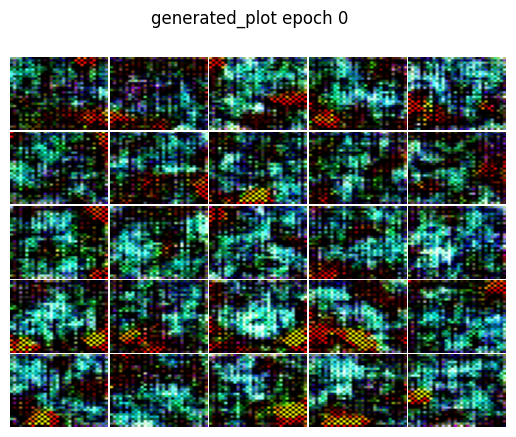

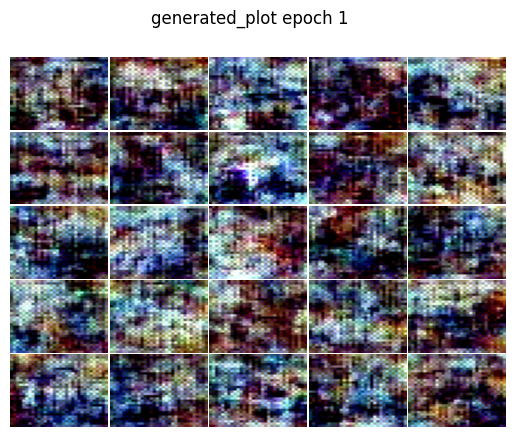

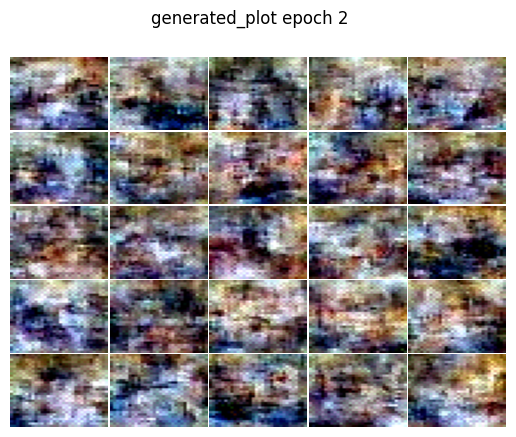

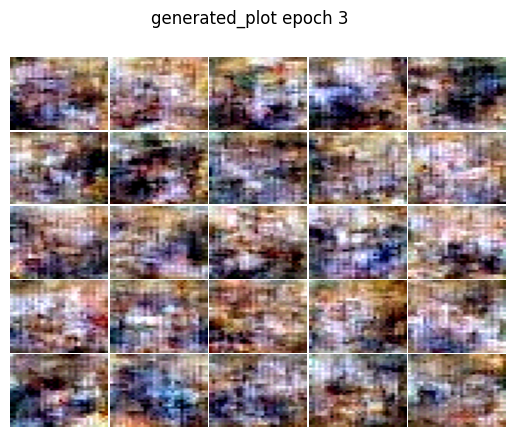

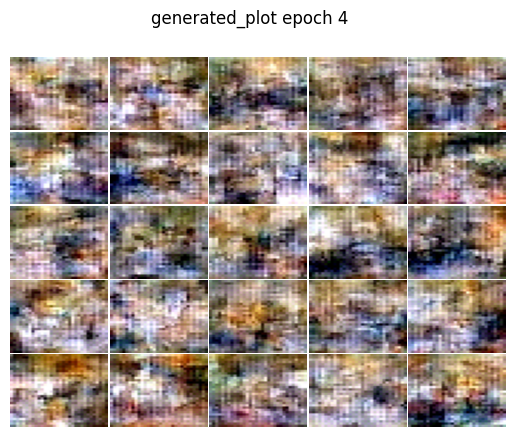

...

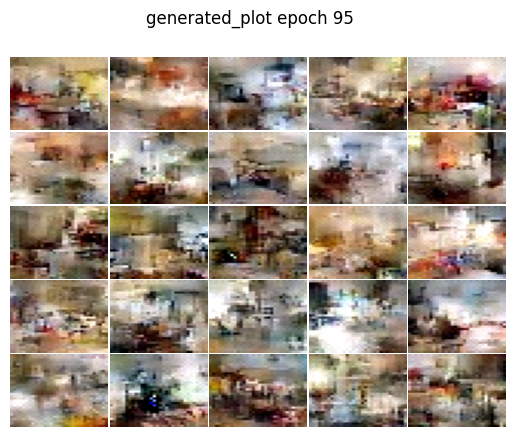

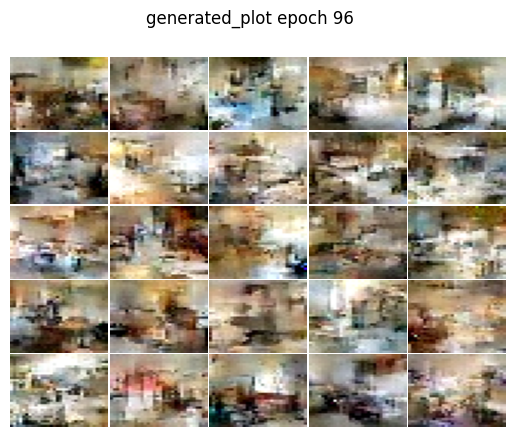

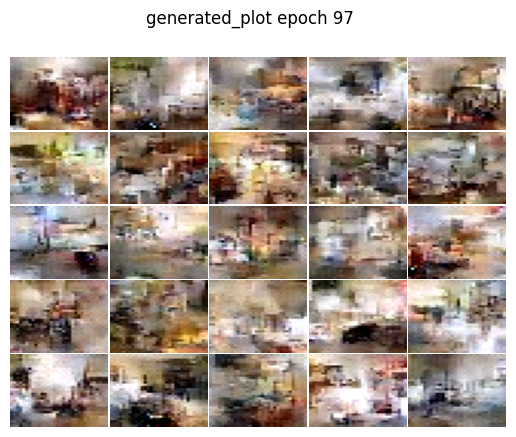

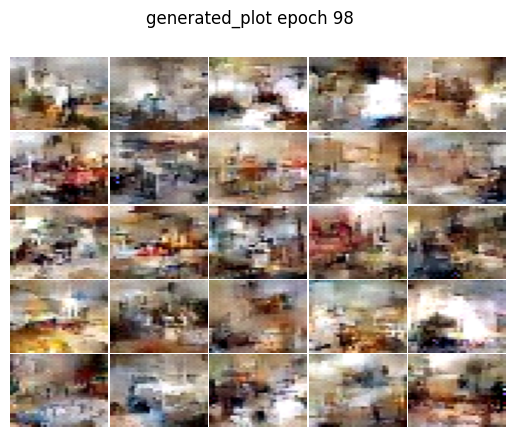

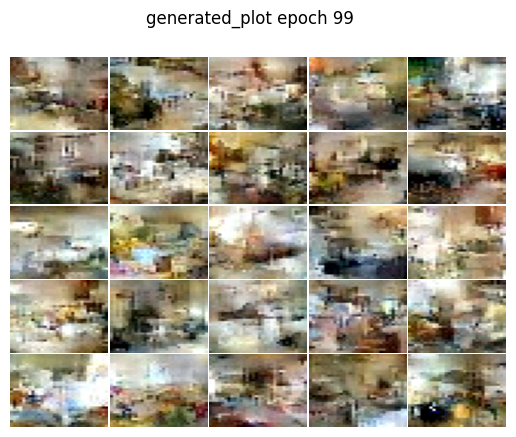

In [14]:
# plotting
n_row, n_column = 5, 5

epochs = 20

loss_per_epoch = []
for e in range(0, epochs + 80):
    loss_per_bath = []
    for i, data in enumerate(dataloader):
        image_batch = data.to(device)
        optimizer.zero_grad()
        z, loss = realnvp(image_batch)
        loss.backward()
        optimizer.step()
        if i % 99 == 0:
            print(f"epcoh {e}, batch {i}, loss {loss}")
        loss_per_bath.append(loss)
    
    epoch_loss = torch.Tensor(loss_per_bath).mean()
    print(f"epoch {e}, loss: {epoch_loss}")
    generated_image = realnvp.sample(n_row * n_column).view(n_row, n_column, 3, 32, 32)
    save_plot(n_row=n_row, n_column=n_column, path="./plots_deeper_resnet", generated_image=generated_image, epoch=e)
    loss_per_epoch.append(epoch_loss)